# Week 1 Assignment

## Data Extraction and EDA

Import training and testing data as a dataframe

In [1]:
import pandas as pd
train_file_path = 'corrected train set.csv'
test_file_path = 'week 1 test.csv'
train_data = pd.read_csv(train_file_path, index_col='id')
test_data = pd.read_csv(test_file_path, index_col = 'id')

In [2]:
set(train_data.columns) - set(test_data.columns)

{'failure'}

In [3]:
train_data.describe()

,loading,attribute_2,attribute_3,measurement_0,measurement_1,measurement_2,measurement_3,measurement_4,measurement_5,measurement_6,...,measurement_9,measurement_10,measurement_11,measurement_12,measurement_13,measurement_14,measurement_15,measurement_16,measurement_17,failure
count,15969.000000,16108.000000,16108.000000,16108.000000,16108.000000,16108.000000,15880.000000,15788.000000,15681.000000,15618.000000,...,15363.000000,15303.000000,15230.000000,15151.000000,15056.000000,15024.000000,14905.000000,14819.000000,14763.000000,16108.000000
mean,127.654870,7.244226,7.050161,7.898498,7.229513,6.171840,17.795995,11.728396,17.135528,17.503114,...,11.429720,16.115783,19.094749,11.779714,15.689460,16.106270,15.030211,16.507123,701.457690,0.212876
std,39.040027,1.721268,1.395508,4.443216,4.023959,3.263784,1.004897,0.998983,0.998751,1.001350,...,0.999876,1.206377,1.648241,1.421943,1.248499,1.473976,1.670008,1.747340,111.867459,0.409353
min,33.160000,5.000000,5.000000,0.000000,0.000000,0.000000,13.968000,8.008000,12.073000,13.968000,...,7.537000,9.676000,12.461000,5.181000,10.890000,9.140000,9.158000,10.264000,287.173000,0.000000
25%,100.020000,5.000000,5.000000,5.000000,4.000000,4.000000,17.124000,11.043000,16.452000,16.828500,...,10.752000,15.340000,17.960250,10.842000,14.864000,15.146750,13.847000,15.272500,627.286500,0.000000
50%,122.160000,8.000000,8.000000,7.000000,7.000000,6.000000,17.789000,11.733000,17.140000,17.508000,...,11.434000,16.127000,19.159000,11.823000,15.653000,16.071500,15.006000,16.423000,700.743000,0.000000
75%,148.640000,9.000000,8.000000,11.000000,10.000000,8.000000,18.475000,12.413250,17.810000,18.181000,...,12.100500,16.894000,20.263750,12.747000,16.456000,17.080000,16.177000,17.692000,776.150000,0.000000
max,385.860000,9.000000,8.000000,29.000000,27.000000,21.000000,21.499000,16.484000,21.425000,21.543000,...,15.412000,22.479000,25.640000,17.392000,22.713000,22.303000,21.626000,24.094000,1107.479000,1.000000


In [239]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 13285 entries, 0 to 16107
Data columns (total 24 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   loading         13161 non-null  float64
 1   attribute_0     13285 non-null  object 
 2   attribute_1     13285 non-null  object 
 3   attribute_2     13285 non-null  int64  
 4   attribute_3     13285 non-null  int64  
 5   measurement_0   13285 non-null  int64  
 6   measurement_1   13285 non-null  int64  
 7   measurement_2   13285 non-null  int64  
 8   measurement_3   13096 non-null  float64
 9   measurement_4   13014 non-null  float64
 10  measurement_5   12950 non-null  float64
 11  measurement_6   12872 non-null  float64
 12  measurement_7   12830 non-null  float64
 13  measurement_8   12764 non-null  float64
 14  measurement_9   12663 non-null  float64
 15  measurement_10  12630 non-null  float64
 16  measurement_11  12573 non-null  float64
 17  measurement_12  12493 non-null 

We notice that attributes 2 and 3 are single digited integers, attributes 1 and 2 are categorical. Measurements 0 to 16 are range up double digits. whereas loading and measurement_17 range up till 1000, we shall ensure that all these variables are scaled down to same value range to ensure that Optimisation happens faster(i.e., would require lesser number of iterations)

In [4]:
train_data.isnull().sum()

#Several Missing Values

product_code         0
loading            139
attribute_0          0
attribute_1          0
attribute_2          0
attribute_3          0
measurement_0        0
measurement_1        0
measurement_2        0
measurement_3      228
measurement_4      320
measurement_5      427
measurement_6      490
measurement_7      560
measurement_8      640
measurement_9      745
measurement_10     805
measurement_11     878
measurement_12     957
measurement_13    1052
measurement_14    1084
measurement_15    1203
measurement_16    1289
measurement_17    1345
failure              0
dtype: int64

In [5]:
train_data.failure.value_counts()

#Imbalanced Data!

0    12679
1     3429
Name: failure, dtype: int64

In [6]:
train_data.duplicated().sum()

#No duplicated data

0

In [7]:
for col in train_data.columns:
    print(col, ':' , train_data[col].nunique())

product_code : 3
loading : 9390
attribute_0 : 2
attribute_1 : 2
attribute_2 : 3
attribute_3 : 2
measurement_0 : 28
measurement_1 : 27
measurement_2 : 22
measurement_3 : 4282
measurement_4 : 4222
measurement_5 : 4220
measurement_6 : 4228
measurement_7 : 4254
measurement_8 : 4239
measurement_9 : 4219
measurement_10 : 4834
measurement_11 : 5961
measurement_12 : 5404
measurement_13 : 4887
measurement_14 : 5527
measurement_15 : 5989
measurement_16 : 6134
measurement_17 : 14508
failure : 2


In [8]:
train_data.head()

,product_code,loading,attribute_0,attribute_1,attribute_2,attribute_3,measurement_0,measurement_1,measurement_2,measurement_3,...,measurement_9,measurement_10,measurement_11,measurement_12,measurement_13,measurement_14,measurement_15,measurement_16,measurement_17,failure
id,,,,,,,,,,,,,,,,,,,,,
0,A,80.10,material_7,material_8,9,5,7,8,4,18.040,...,10.672,15.859,17.594,15.193,15.029,NaN,13.034,14.684,764.100,0
1,A,84.89,material_7,material_8,9,5,14,3,3,18.213,...,12.448,17.947,17.915,11.755,14.732,15.425,14.395,15.631,682.057,0
2,A,82.43,material_7,material_8,9,5,12,1,5,18.057,...,12.715,15.607,NaN,13.798,16.711,18.631,14.094,17.946,663.376,0
3,A,101.07,material_7,material_8,9,5,13,2,6,17.295,...,12.471,16.346,18.377,10.020,15.250,15.562,16.154,17.172,826.282,0
4,A,188.06,material_7,material_8,9,5,9,2,8,19.346,...,10.337,17.082,19.932,12.428,16.182,12.760,13.153,16.412,579.885,0


## Data Visualisation

In [9]:
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

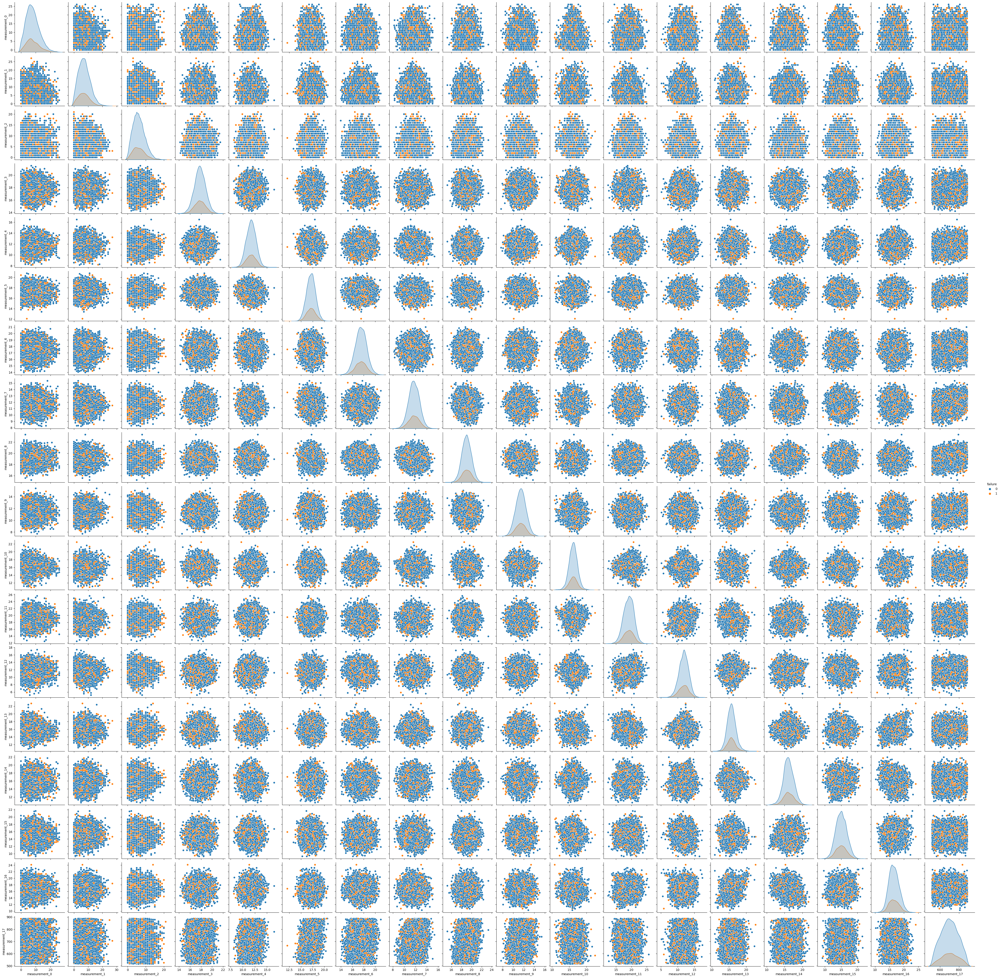

In [240]:
df = train_data[[f'measurement_{i}' for i in range(18)] + ['failure']]
sns.pairplot(df, hue = 'failure')

<AxesSubplot:>

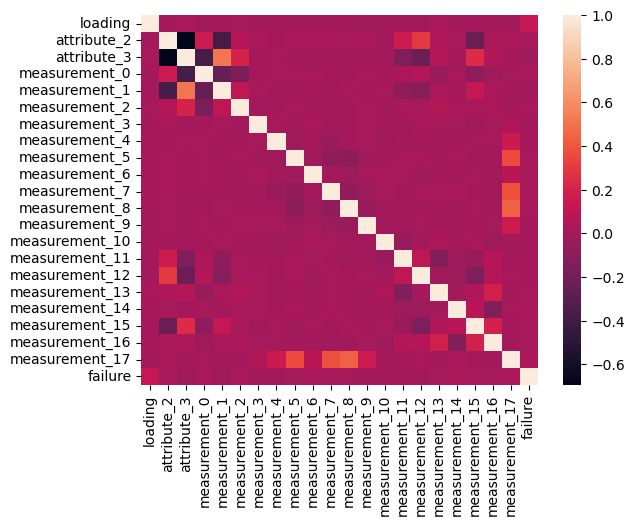

In [241]:
train = train_data.copy()
train['failure'] = train['failure'].astype('category')
train['failure'] = train['failure'].cat.codes
sns.heatmap(train.corr())

Results of Data Visualisation:
<ul>
    <li>Unclean Dataset. Several Missing Values. Since distribution is Gaussian, we replace them safely by their mean.</li>
    <li>Slightly Imbalanced Dataset, only 21% of the training examples are failures. </li>
    <li>Some features have very less unique values, hence can be used as categorical variables, such as all the attributes and measurement 0,1</li>
    <li>Pair Plots conclude that no two measurement features are highly correlated, so all of them are almost independent of each other. </li>
</ul>

## Removing Outliers

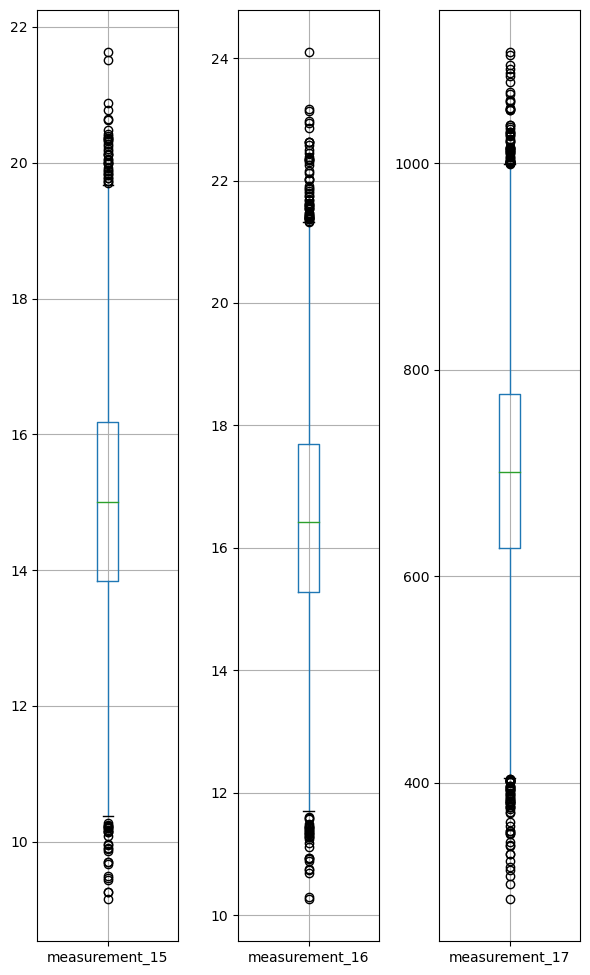

In [166]:
fig = plt.figure(figsize=(6,10))

ax1 = plt.subplot(131)
ax2 = plt.subplot(132)
ax3 = plt.subplot(133)

df.boxplot(column='measurement_15', ax=ax1)
df.boxplot(column='measurement_16', ax=ax2)
df.boxplot(column='measurement_17', ax=ax3)

plt.suptitle('')
plt.tight_layout()

In [13]:
#We remove product_code as we don't find it to have major dependence anywhere
train_data.drop('product_code', axis=1, inplace=True)
train_data.head()

,loading,attribute_0,attribute_1,attribute_2,attribute_3,measurement_0,measurement_1,measurement_2,measurement_3,measurement_4,...,measurement_9,measurement_10,measurement_11,measurement_12,measurement_13,measurement_14,measurement_15,measurement_16,measurement_17,failure
id,,,,,,,,,,,,,,,,,,,,,
0,80.10,material_7,material_8,9,5,7,8,4,18.040,12.518,...,10.672,15.859,17.594,15.193,15.029,NaN,13.034,14.684,764.100,0
1,84.89,material_7,material_8,9,5,14,3,3,18.213,11.540,...,12.448,17.947,17.915,11.755,14.732,15.425,14.395,15.631,682.057,0
2,82.43,material_7,material_8,9,5,12,1,5,18.057,11.652,...,12.715,15.607,NaN,13.798,16.711,18.631,14.094,17.946,663.376,0
3,101.07,material_7,material_8,9,5,13,2,6,17.295,11.188,...,12.471,16.346,18.377,10.020,15.250,15.562,16.154,17.172,826.282,0
4,188.06,material_7,material_8,9,5,9,2,8,19.346,12.950,...,10.337,17.082,19.932,12.428,16.182,12.760,13.153,16.412,579.885,0


In [147]:
# We declare values in top 5% and lower 5% as outliers
outliers1 = df.drop(['failure','measurement_0','measurement_1','measurement_2'], axis=1).quantile(0.95)
outliers2 = df.drop(['failure','measurement_0','measurement_1','measurement_2'], axis=1).quantile(0.05)
outliers2

measurement_3      16.15095
measurement_4      10.09100
measurement_5      15.50500
measurement_6      15.84200
measurement_7      10.06200
measurement_8      17.36100
measurement_9       9.77500
measurement_10     14.15610
measurement_11     16.34445
measurement_12      9.37450
measurement_13     13.73175
measurement_14     13.71500
measurement_15     12.37620
measurement_16     13.81470
measurement_17    516.08140
Name: 0.05, dtype: float64

In [149]:
#Removing the outliers
for i in [f'measurement_{i}' for i in range(3,18)]:
    df1=train_data[(df[i]<outliers1[i])]
for i in [f'measurement_{i}' for i in range(3,18)]:
    df2=df1[(df1[i]>outliers2[i])]

print(df2.shape, df1.shape, df.shape)
train_data = df2

# df2.failure.value_counts()
# df2.head()

(13285, 24) (14024, 24) (16108, 19)


## Building the Pipeline

In [150]:
#Importing all the necessary modules
from sklearn.preprocessing import LabelEncoder, StandardScaler, OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import accuracy_score, roc_auc_score
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer

We have two types of features, one is numerical, other is categorical. We replace the missing values in numerical columns by their mean, because we find the distributions to resemble gaussian. For the categorical columns, the missing values are replaced by the mode. We one hot encode the categorical cols to represent them also as numerical cols

In [152]:
#Separating Categorical and Numerical Columns
categorical_cols = ['attribute_0', 'attribute_1']
numerical_cols = [f'measurement_{i}' for i in range(18)]

In [153]:
#For the numerical Columns, we 
numerical_transformer = Pipeline(steps = [
    ('impute',SimpleImputer(strategy = 'mean'))
])


categorical_transformer = Pipeline(steps = [
    ('imputer', SimpleImputer(strategy = 'most_frequent')),
    ('onehot', OneHotEncoder(handle_unknown = 'ignore'))
])

preprocessor = ColumnTransformer( transformers= [
    ('num', numerical_transformer, numerical_cols),
    ('cat', categorical_transformer, categorical_cols)
])

# preprocessor.transformers

In [154]:
pipeline = Pipeline([
    ('preprocessor', preprocessor), #Step0 - preprocessing data
    ('normalizer', StandardScaler()), #Step1 - normalize data
    ('clf', LogisticRegression()) #step2 - classifier
])
# Choosing class_weight = 'balanced' reduces the F1score and accuracy, whereas the AUC remains almost same, now the predictions
# look no longer biased, but also in becomes now over cautious where it shouldn't. The number of predictions as false reduced 
# more than it should.
pipeline.steps

[('preprocessor',
  ColumnTransformer(transformers=[('num',
                                   Pipeline(steps=[('impute', SimpleImputer())]),
                                   ['measurement_0', 'measurement_1',
                                    'measurement_2', 'measurement_3',
                                    'measurement_4', 'measurement_5',
                                    'measurement_6', 'measurement_7',
                                    'measurement_8', 'measurement_9',
                                    'measurement_10', 'measurement_11',
                                    'measurement_12', 'measurement_13',
                                    'measurement_14', 'measurement_15',
                                    'measurement_16', 'measurement_17']),
                                  ('cat',
                                   Pipeline(steps=[('imputer',
                                                    SimpleImputer(strategy='most_frequent')),
                   

## Trying Models

### Trying the Logistic Regression Model

In [155]:
#Splitting the Avialable data into training and validation sets
X_train, X_valid, y_train, y_valid = train_test_split( train_data, train_data['failure'], 
                                                                      test_size = 0.25, random_state = 10)
print(X_train.shape)
print(X_valid.shape)
print(y_train.shape)
print(y_valid.shape)

(9963, 24)
(3322, 24)
(9963,)
(3322,)


We use the cross validation score which performs pipeline operations of the available data cv number of times,and reports the average score

In [156]:
#The feature_matrix and target_values of available data
X = train_data.drop('failure', axis=1)
y = train_data.failure

#Evaluating the Pipeline with Logistic Regression model
scores = cross_val_score(pipeline, X, y, cv = 5, scoring='accuracy')
print('Accuracy:',scores.mean()*100)
f1_scores = cross_val_score(pipeline, X, y, cv = 5, scoring='f1_weighted')
print('F1:',f1_scores.mean())
# F1 score Calculate metrics for each label, and find their average weighted by support (the number of true instances for each label). 
# This alters ‘macro’ to account for label imbalance; it can result in an F-score that is not between precision and recall.
auc_scores = cross_val_score(pipeline, X,y, cv = 5, scoring='roc_auc')
print('AUC_ROC:',auc_scores.mean())

Accuracy: 51.88558524651863
F1: 0.527891816223952
AUC_ROC: 0.5164089652811017


In [157]:
pipeline.fit(X_train, y_train)
preds = pipeline.predict(X_valid)
values = pd.DataFrame(pipeline.predict_proba(X_valid))

In [158]:
print(sum(preds==0), sum(y_valid==0))
print(sum(preds==1), sum(y_valid==1))
values.describe()
# My model just predicts 0, all the time! And its accuracy was good, nearly 80, that is because my data is skewed.

1761 2569
1561 753


,0,1
count,3322.000000,3322.000000
mean,0.502118,0.497882
std,0.036553,0.036553
min,0.369913,0.375032
25%,0.477501,0.472931
50%,0.502700,0.497300
75%,0.527069,0.522499
max,0.624968,0.630087


**Hyperparameter Tuning - Grid Search** - We can improve your accuracy by performing a Grid Search to tune the hyperparameters of your model. For example in case of LogisticRegression, the parameter C is a hyperparameter. Also, we should avoid using the test data during grid search. Instead perform cross validation. We use our test data only to report the final numbers for our final model. GridSearch should be done for all models that we try because then only you will be able to tell what is the best you can get from each model. Scikit-Learn provides the GridSearchCV class for this.

**Explore more classifiers** - Logistic Regression learns a linear decision surface that separates our classes. It could be possible that your 2 classes may not be linearly separable. In such a case we might need to look at other classifiers such asSupport Vector Machines which are able to learn more complex decision boundaries. We can also look at Tree-Based classifiers such as Decision Trees which can learn rules from your data.

**More Features** - If all of this fails, then that means that you should start looking for more features.



### Trying other Classifiers 

In [242]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB

from sklearn.metrics import accuracy_score, roc_auc_score, f1_score,confusion_matrix
import numpy as np

In [178]:
clfs = []
clfs.append(LogisticRegression())
clfs.append(SVC())
clfs.append(KNeighborsClassifier(n_neighbors=3))
clfs.append(DecisionTreeClassifier())
clfs.append(RandomForestClassifier())
clfs.append(GradientBoostingClassifier())
clfs.append(XGBClassifier())
clfs.append(GaussianNB())

accuracy = []
F1 = []
auc = []
auc_weighted = []
cm = []

for classifier in clfs:
    print(str(classifier))
    pipeline.set_params(clf = classifier)
    pipeline.fit(X_train, y_train)
    preds = pipeline.predict(X_valid)
    
    acc_score = accuracy_score(y_valid, preds)*100
    print('Accuracy:',acc_score)
    accuracy.append(acc_score)
    
    f1_scor = f1_score(y_valid, preds, average='weighted')
    print('F1:', f1_scor)
    F1.append(f1_scor)
    
    auc_score = roc_auc_score(y_valid, preds)
    print('AUC_ROC:',auc_score)
    auc.append(auc_score)
    
    auc_score = roc_auc_score(y_valid, preds,average='weighted' )
    print('AUC_ROC_weighted:',auc_score)
    auc_weighted.append(auc_score)
    
    cm.append(confusion_matrix(y_valid, preds))
    print('Confusion Matrix Added')
    
    print('-----------------------------------')

LogisticRegression()
Accuracy: 77.33293196869356
F1: 0.6744807408846503
AUC_ROC: 0.5
AUC_ROC_weighted: 0.5
Confusion Matrix Added
-----------------------------------
SVC()
Accuracy: 77.33293196869356
F1: 0.6744807408846503
AUC_ROC: 0.5
AUC_ROC_weighted: 0.5
Confusion Matrix Added
-----------------------------------
KNeighborsClassifier(n_neighbors=3)


C:\Users\sabya\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


Accuracy: 70.43949428055389
F1: 0.669353337193712
AUC_ROC: 0.49673577649955514
AUC_ROC_weighted: 0.49673577649955514
Confusion Matrix Added
-----------------------------------
DecisionTreeClassifier()
Accuracy: 65.53281155930163
F1: 0.6534233549289138
AUC_ROC: 0.5030313416116253
AUC_ROC_weighted: 0.5030313416116253
Confusion Matrix Added
-----------------------------------
RandomForestClassifier()
Accuracy: 77.3630343166767
F1: 0.6751965022327778
AUC_ROC: 0.50066401062417
AUC_ROC_weighted: 0.50066401062417
Confusion Matrix Added
-----------------------------------
GradientBoostingClassifier()
Accuracy: 77.30282962071041
F1: 0.6771311952035575
AUC_ROC: 0.5021522835607098
AUC_ROC_weighted: 0.5021522835607098
Confusion Matrix Added
-----------------------------------
XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False

We observe all models, have almost same auc_score, It shall be tough for us to now decide on what model to be chosen

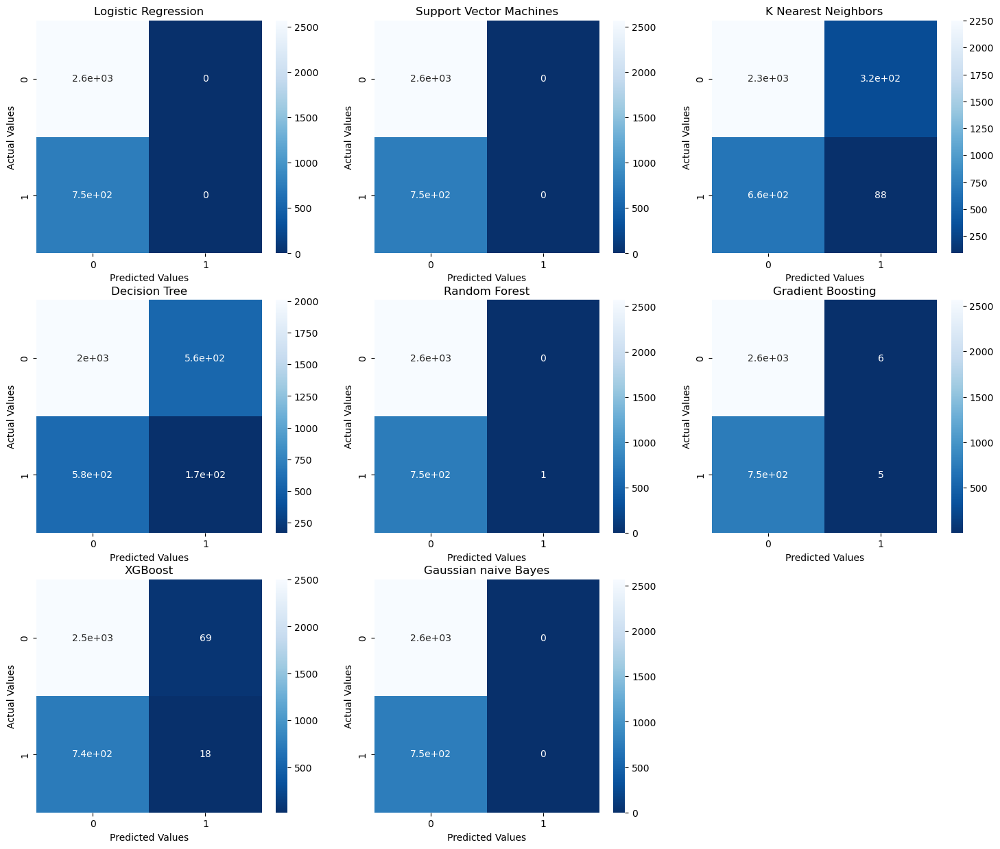

In [180]:
model_list = ['Logistic Regression', 'Support Vector Machines','K Nearest Neighbors', 'Decision Tree', 'Random Forest','Gradient Boosting', 'XGBoost', 'Gaussian naive Bayes',]
cm_list = cm

fig = plt.figure(figsize=(18,15))
for i in range(len(cm_list)):
    cm = cm_list[i]
    model = model_list[i]
    sub = fig.add_subplot(3,3,i+1).set_title(model)
    cm_plot = sns.heatmap(cm, annot=True, cmap='Blues_r')
    cm_plot.set_xlabel('Predicted Values')
    cm_plot.set_ylabel('Actual Values')


All models are performing bad. Only thing we can do now, is to try of ensemble techniques, where we club up several models to give better predictions.

### Hyperparameter Tuning for Logistic Regression

In [161]:
from sklearn.model_selection import GridSearchCV

pipeline.set_params(clf = LogisticRegression())

[('preprocessor',
  ColumnTransformer(transformers=[('num',
                                   Pipeline(steps=[('impute', SimpleImputer())]),
                                   ['measurement_0', 'measurement_1',
                                    'measurement_2', 'measurement_3',
                                    'measurement_4', 'measurement_5',
                                    'measurement_6', 'measurement_7',
                                    'measurement_8', 'measurement_9',
                                    'measurement_10', 'measurement_11',
                                    'measurement_12', 'measurement_13',
                                    'measurement_14', 'measurement_15',
                                    'measurement_16', 'measurement_17']),
                                  ('cat',
                                   Pipeline(steps=[('imputer',
                                                    SimpleImputer(strategy='most_frequent')),
                   

In [162]:
cv_grid = GridSearchCV(pipeline, param_grid = {
    'clf__class_weight' : ['balanced', None],
    'clf__C' : np.linspace(0.1,1.5,15),
    'clf__solver' : ['liblinear', 'lbfgs']
}, scoring='roc_auc', n_jobs=2)

cv_grid.fit(X_train, y_train)

GridSearchCV(estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('num',
                                                                         Pipeline(steps=[('impute',
                                                                                          SimpleImputer())]),
                                                                         ['measurement_0',
                                                                          'measurement_1',
                                                                          'measurement_2',
                                                                          'measurement_3',
                                                                          'measurement_4',
                                                                          'measurement_5',
                                                                          'measurement_6',
                 

In [163]:
pd.DataFrame(cv_grid.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_clf__C,param_clf__class_weight,param_clf__solver,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.048707,0.004740,0.023243,0.013740,0.1,balanced,liblinear,"{'clf__C': 0.1, 'clf__class_weight': 'balanced...",0.503629,0.529739,0.513317,0.512949,0.525489,0.517024,0.009414,1
1,0.043072,0.007640,0.010911,0.003878,0.1,balanced,lbfgs,"{'clf__C': 0.1, 'clf__class_weight': 'balanced...",0.503634,0.529730,0.513308,0.512946,0.525497,0.517023,0.009412,2
2,0.047273,0.004550,0.011235,0.003042,0.1,None,liblinear,"{'clf__C': 0.1, 'clf__class_weight': None, 'cl...",0.503144,0.529943,0.513147,0.511594,0.525267,0.516619,0.009708,32
3,0.035194,0.002015,0.008328,0.000442,0.1,None,lbfgs,"{'clf__C': 0.1, 'clf__class_weight': None, 'cl...",0.503182,0.529944,0.513136,0.511588,0.525271,0.516624,0.009700,31
4,0.042370,0.005298,0.007932,0.001214,0.2,balanced,liblinear,"{'clf__C': 0.2, 'clf__class_weight': 'balanced...",0.503660,0.529629,0.513324,0.512908,0.525535,0.517011,0.009387,11
5,0.035076,0.001289,0.007722,0.001020,0.2,balanced,lbfgs,"{'clf__C': 0.2, 'clf__class_weight': 'balanced...",0.503670,0.529628,0.513320,0.512906,0.525538,0.517012,0.009384,6
6,0.041112,0.001066,0.008794,0.000228,0.2,None,liblinear,"{'clf__C': 0.2, 'clf__class_weight': None, 'cl...",0.503208,0.529790,0.513121,0.511464,0.525294,0.516575,0.009669,35
7,0.037235,0.001039,0.008715,0.000478,0.2,None,lbfgs,"{'clf__C': 0.2, 'clf__class_weight': None, 'cl...",0.503223,0.529793,0.513116,0.511478,0.525303,0.516583,0.009666,33
8,0.042466,0.001770,0.008820,0.000740,0.3,balanced,liblinear,"{'clf__C': 0.3, 'clf__class_weight': 'balanced...",0.503681,0.529591,0.513330,0.512915,0.525539,0.517011,0.009370,10
9,0.040233,0.003049,0.009374,0.001163,0.3,balanced,lbfgs,"{'clf__C': 0.3, 'clf__class_weight': 'balanced...",0.503678,0.529585,0.513312,0.512918,0.525522,0.517003,0.009368,30


In [164]:
cv_grid.best_score_

0.5170244336266416

In [165]:
cv_grid.best_params_

{'clf__C': 0.1, 'clf__class_weight': 'balanced', 'clf__solver': 'liblinear'}

### Hyperparameter Tuning for DecisionTreeClassifier

In [182]:
pipeline.set_params(clf = DecisionTreeClassifier())
pipeline.steps

[('preprocessor',
  ColumnTransformer(transformers=[('num',
                                   Pipeline(steps=[('impute', SimpleImputer())]),
                                   ['measurement_0', 'measurement_1',
                                    'measurement_2', 'measurement_3',
                                    'measurement_4', 'measurement_5',
                                    'measurement_6', 'measurement_7',
                                    'measurement_8', 'measurement_9',
                                    'measurement_10', 'measurement_11',
                                    'measurement_12', 'measurement_13',
                                    'measurement_14', 'measurement_15',
                                    'measurement_16', 'measurement_17']),
                                  ('cat',
                                   Pipeline(steps=[('imputer',
                                                    SimpleImputer(strategy='most_frequent')),
                   

In [183]:
cv_grid = GridSearchCV(pipeline, param_grid = {
    'clf__splitter' : ['best', 'random'],
    'clf__min_samples_split' : [2,5,10,15,20],
    'clf__min_samples_leaf' : [1,2,5,10],
    'clf__random_state' : [27,54,81,108]
}, scoring='roc_auc', n_jobs=2)

cv_grid.fit(X_train, y_train)

GridSearchCV(estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('num',
                                                                         Pipeline(steps=[('impute',
                                                                                          SimpleImputer())]),
                                                                         ['measurement_0',
                                                                          'measurement_1',
                                                                          'measurement_2',
                                                                          'measurement_3',
                                                                          'measurement_4',
                                                                          'measurement_5',
                                                                          'measurement_6',
                 

In [184]:
cv_grid.best_score_

0.5185148981605454

In [185]:
cv_grid.best_params_

{'clf__min_samples_leaf': 5,
 'clf__min_samples_split': 2,
 'clf__random_state': 54,
 'clf__splitter': 'random'}

### Hyperparameter Tuning for KNeighborsClassifier

In [187]:
pipeline.set_params(clf = KNeighborsClassifier())
pipeline.steps

[('preprocessor',
  ColumnTransformer(transformers=[('num',
                                   Pipeline(steps=[('impute', SimpleImputer())]),
                                   ['measurement_0', 'measurement_1',
                                    'measurement_2', 'measurement_3',
                                    'measurement_4', 'measurement_5',
                                    'measurement_6', 'measurement_7',
                                    'measurement_8', 'measurement_9',
                                    'measurement_10', 'measurement_11',
                                    'measurement_12', 'measurement_13',
                                    'measurement_14', 'measurement_15',
                                    'measurement_16', 'measurement_17']),
                                  ('cat',
                                   Pipeline(steps=[('imputer',
                                                    SimpleImputer(strategy='most_frequent')),
                   

In [196]:
cv_grid = GridSearchCV(pipeline, param_grid = {
    'clf__weights' : ['uniform', 'distance'],
    'clf__n_neighbors' : [5,7],
    'clf__p' : [1,2]
}, scoring='roc_auc', n_jobs=2)

cv_grid.fit(X_train, y_train)

GridSearchCV(estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('num',
                                                                         Pipeline(steps=[('impute',
                                                                                          SimpleImputer())]),
                                                                         ['measurement_0',
                                                                          'measurement_1',
                                                                          'measurement_2',
                                                                          'measurement_3',
                                                                          'measurement_4',
                                                                          'measurement_5',
                                                                          'measurement_6',
                 

In [197]:
cv_grid.best_score_

0.5108660551139442

In [198]:
cv_grid.best_params_

{'clf__n_neighbors': 5, 'clf__p': 2, 'clf__weights': 'uniform'}

### Checking best combination of ensembled pairs

In [244]:
from sklearn.ensemble import VotingClassifier

def auc_f1_acc_evaluate(eclf1):
    pipeline.set_params(clf = eclf1)
    pipeline.fit(X_train, y_train)
    preds = (pipeline.predict(X_valid))
    print('AUC:',roc_auc_score(y_valid, preds, average='weighted'))
    print('F1:',f1_score(y_valid, preds, average='weighted'))
    print('Accuracy:',accuracy_score(y_valid, preds))
    return roc_auc_score(y_valid, preds, average='weighted')

In [231]:
from itertools import combinations

models = [('lr',LogisticRegression(C = 0.1, class_weight = 'balanced', solver='liblinear')), ('knn',KNeighborsClassifier(n_neighbors=5, p=2, weights='uniform')),
          ('dtc',DecisionTreeClassifier(min_samples_leaf=5,min_samples_split=2, random_state=54, splitter='random' )),
          ('rfr',RandomForestClassifier(n_estimators=270)),('xgb',XGBClassifier()), ('gnb',GaussianNB())]
comb_auc = {}
combs = list(combinations(models, 2))
for comb in combs:
    print(comb)
    comb_auc[comb] = auc_f1_acc_evaluate(VotingClassifier(estimators=comb, voting='hard'))
    print('------------------')

(('lr', LogisticRegression(C=0.1, class_weight='balanced', solver='liblinear')), ('knn', KNeighborsClassifier()))


C:\Users\sabya\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


AUC: 0.5033425400512909
F1: 0.6808511296368124
Accuracy: 0.7552679108970499
------------------
(('lr', LogisticRegression(C=0.1, class_weight='balanced', solver='liblinear')), ('dtc', DecisionTreeClassifier(min_samples_leaf=5, random_state=54, splitter='random')))
AUC: 0.5031703987217084
F1: 0.6797821470116736
Accuracy: 0.7354003612281758
------------------
(('lr', LogisticRegression(C=0.1, class_weight='balanced', solver='liblinear')), ('rfr', RandomForestClassifier(n_estimators=270)))
AUC: 0.5
F1: 0.6744807408846503
Accuracy: 0.7733293196869356
------------------
(('lr', LogisticRegression(C=0.1, class_weight='balanced', solver='liblinear')), ('xgb', XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=N

C:\Users\sabya\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


AUC: 0.4986603475807423
F1: 0.6751510810441865
Accuracy: 0.7639975918121613
------------------
(('knn', KNeighborsClassifier()), ('rfr', RandomForestClassifier(n_estimators=270)))


C:\Users\sabya\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


AUC: 0.5
F1: 0.6744807408846503
Accuracy: 0.7733293196869356
------------------
(('knn', KNeighborsClassifier()), ('xgb', XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)))


C:\Users\sabya\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


AUC: 0.4983284715038897
F1: 0.673406756447919
Accuracy: 0.7700180614087899
------------------
(('knn', KNeighborsClassifier()), ('gnb', GaussianNB()))


C:\Users\sabya\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


AUC: 0.5
F1: 0.6744807408846503
Accuracy: 0.7733293196869356
------------------
(('dtc', DecisionTreeClassifier(min_samples_leaf=5, random_state=54, splitter='random')), ('rfr', RandomForestClassifier(n_estimators=270)))
AUC: 0.5
F1: 0.6744807408846503
Accuracy: 0.7733293196869356
------------------
(('dtc', DecisionTreeClassifier(min_samples_leaf=5, random_state=54, splitter='random')), ('xgb', XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan,

In [232]:
result_df = pd.DataFrame({'Models':list(comb_auc.keys()), 'AUC_Score':list(comb_auc.values())})
result_df

,Models,AUC_Score
0,"((lr, LogisticRegression(C=0.1, class_weight='...",0.503343
1,"((lr, LogisticRegression(C=0.1, class_weight='...",0.503170
2,"((lr, LogisticRegression(C=0.1, class_weight='...",0.500000
3,"((lr, LogisticRegression(C=0.1, class_weight='...",0.498351
4,"((lr, LogisticRegression(C=0.1, class_weight='...",0.500000
5,"((knn, KNeighborsClassifier()), (dtc, Decision...",0.498660
6,"((knn, KNeighborsClassifier()), (rfr, RandomFo...",0.500000
7,"((knn, KNeighborsClassifier()), (xgb, XGBClass...",0.498328
8,"((knn, KNeighborsClassifier()), (gnb, Gaussian...",0.500000
9,"((dtc, DecisionTreeClassifier(min_samples_leaf...",0.500000


### Ensembling together the above three models  

We see first three perform well, hence we decide to ensemble them together using VotingClassifier

In [235]:
best_combination = VotingClassifier(estimators=[('lr',LogisticRegression(C = 0.1, class_weight = 'balanced', solver='liblinear')),
                                               ('knn',KNeighborsClassifier(p=2, n_neighbors=5, weights='uniform')),
                                               ('dtc', DecisionTreeClassifier(min_samples_leaf=5, min_samples_split=2, random_state=54, splitter='random'))],
                                               voting='hard')
auc_f1_acc_evaluate(best_combination)                      

AUC: 0.503662268016296
F1: 0.676500298357663
Accuracy: 0.715833835039133


C:\Users\sabya\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)


0.503662268016296

### Neural Networks

In [237]:
# 0.503 is the best score achievable so far.
# several tries of all combinations led to just disappointment

#We try to check Neural Networks
#No improvement found over here as well
from sklearn.neural_network import MLPClassifier

clf = MLPClassifier(solver='lbfgs', alpha=1e-2, hidden_layer_sizes=(7,2), random_state=786, max_iter = 10000)
auc_f1_acc_evaluate(clf)

AUC: 0.5
F1: 0.6744807408846503
Accuracy: 0.7733293196869356


0.5

### Predicting failure probabilities of test data

In [266]:
best_combination = VotingClassifier(estimators=[('lr',LogisticRegression(C = 0.1, class_weight = 'balanced', solver='liblinear')),
                                               ('knn',KNeighborsClassifier(p=2, n_neighbors=5, weights='uniform')),
                                               ('dtc', DecisionTreeClassifier(min_samples_leaf=5, min_samples_split=2, random_state=54, splitter='random'))],
                                               voting='soft')
pipeline.set_params(clf = best_combination)
pipeline.fit(X, y)
predictions = pd.DataFrame(pipeline.predict_proba(test_data))

In [269]:
predictions.index = test_data.index
predictions.head()

,0,1
id,,
16108,0.642509,0.357491
16109,0.611589,0.388411
16110,0.710350,0.289650
16111,0.537878,0.462122
16112,0.783506,0.216494


In [270]:
predictions.drop(0, axis=1, inplace=True)
predictions.head()

,1
id,
16108,0.357491
16109,0.388411
16110,0.289650
16111,0.462122
16112,0.216494


In [271]:
predictions = predictions.rename(columns={1: 'failure'})
predictions.head()

,failure
id,
16108,0.357491
16109,0.388411
16110,0.289650
16111,0.462122
16112,0.216494


In [272]:
predictions.to_csv("prediction_results.csv")